In [ ]:
#set kaggle credentials
#dont forget to upload kaggle.json first
! chmod 600 kaggle.json && (ls ~/.kaggle 2>/dev/null || mkdir ~/.kaggle) && cp kaggle.json ~/.kaggle/ && echo 'Done'

In [ ]:
#download dataset from kaggle
! apt install unzip


In [ ]:
!unzip "archive.zip" -d ""

In [ ]:
!pip install pandas

Create Data Frame

In [108]:

import pandas as pd

train_data = pd.read_csv('train.csv', encoding = "ISO-8859-1")
test_data = pd.read_csv('test.csv', encoding="ISO-8859-1")
train_data

,textID,text,selected_text,sentiment,Time of Tweet,Age of User,Country,Population -2020,Land Area (Km²),Density (P/Km²)
0,cb774db0d1,"I`d have responded, if I were going","I`d have responded, if I were going",neutral,morning,0-20,Afghanistan,38928346,652860.0,60
1,549e992a42,Sooo SAD I will miss you here in San Diego!!!,Sooo SAD,negative,noon,21-30,Albania,2877797,27400.0,105
2,088c60f138,my boss is bullying me...,bullying me,negative,night,31-45,Algeria,43851044,2381740.0,18
3,9642c003ef,what interview! leave me alone,leave me alone,negative,morning,46-60,Andorra,77265,470.0,164
4,358bd9e861,"Sons of ****, why couldn`t they put them on the releases we already bought","Sons of ****,",negative,noon,60-70,Angola,32866272,1246700.0,26
5,28b57f3990,http://www.dothebouncy.com/smf - some shameless plugging for the best Rangers forum on earth,http://www.dothebouncy.com/smf - some shameless plugging for the best Rangers forum on earth,neutral,night,70-100,Antigua and Barbuda,97929,440.0,223
6,6e0c6d75b1,2am feedings for the baby are fun when he is all smiles and coos,fun,positive,morning,0-20,Argentina,45195774,2736690.0,17
7,50e14c0bb8,Soooo high,Soooo high,neutral,noon,21-30,Armenia,2963243,28470.0,104
8,e050245fbd,Both of you,Both of you,neutral,night,31-45,Australia,25499884,7682300.0,3
9,fc2cbefa9d,Journey!? Wow... u just became cooler. hehe... (is that possible!?),Wow... u just became cooler.,positive,morning,46-60,Austria,9006398,82400.0,109


In [109]:
test_data

,textID,text,sentiment,Time of Tweet,Age of User,Country,Population -2020,Land Area (Km²),Density (P/Km²)
0,f87dea47db,Last session of the day http://twitpic.com/67ezh,neutral,morning,0-20,Afghanistan,3.892835e+07,652860.0,60.0
1,96d74cb729,Shanghai is also really exciting (precisely -- skyscrapers galore). Good tweeps in China: (SH) (BJ).,positive,noon,21-30,Albania,2.877797e+06,27400.0,105.0
2,eee518ae67,"Recession hit Veronique Branquinho, she has to quit her company, such a shame!",negative,night,31-45,Algeria,4.385104e+07,2381740.0,18.0
3,01082688c6,happy bday!,positive,morning,46-60,Andorra,7.726500e+04,470.0,164.0
4,33987a8ee5,http://twitpic.com/4w75p - I like it!!,positive,noon,60-70,Angola,3.286627e+07,1246700.0,26.0
5,726e501993,that`s great!! weee!! visitors!,positive,night,70-100,Antigua and Barbuda,9.792900e+04,440.0,223.0
6,261932614e,I THINK EVERYONE HATES ME ON HERE lol,negative,morning,0-20,Argentina,4.519577e+07,2736690.0,17.0
7,afa11da83f,"soooooo wish i could, but im in school and myspace is completely blocked",negative,noon,21-30,Armenia,2.963243e+06,28470.0,104.0
8,e64208b4ef,and within a short time of the last clue all of them,neutral,night,31-45,Australia,2.549988e+07,7682300.0,3.0
9,37bcad24ca,What did you get? My day is alright.. haven`t done anything yet. leaving soon to my stepsister though!,neutral,morning,46-60,Austria,9.006398e+06,82400.0,109.0


Exploratory Data Analysis

In [ ]:
train_data.dtypes

In [110]:
train_data.isnull().sum()

textID              0
text                1
selected_text       1
sentiment           0
Time of Tweet       0
Age of User         0
Country             0
Population -2020    0
Land Area (Km²)     0
Density (P/Km²)     0
dtype: int64

In [111]:
train_data.dropna(inplace=True)

In [112]:
test_data.isnull().sum()

textID              1281
text                1281
sentiment           1281
Time of Tweet       1281
Age of User         1281
Country             1281
Population -2020    1281
Land Area (Km²)     1281
Density (P/Km²)     1281
dtype: int64

In [113]:
test_data.dropna(inplace=True)

In [114]:
train_data.columns

Index(['textID', 'text', 'selected_text', 'sentiment', 'Time of Tweet',
       'Age of User', 'Country', 'Population -2020', 'Land Area (Km²)',
       'Density (P/Km²)'],
      dtype='object')

In [115]:
#one hot encode the labels
mapping = {"negative": 0, "neutral": 1, "positive": 2}
train_data_encoded = train_data.replace({'sentiment': mapping})
test_data_encoded = test_data.replace({'sentiment': mapping})
df_train_data = pd.DataFrame()
df_test_data = pd.DataFrame()
train_data_text = []
train_data_labels = []
test_data_text = []
test_data_labels = []

In [116]:
import re
def preprocess(in_text):
    # If we have html tags, remove them by this way:
    #out_text = remove_tags(in_text)
    # Remove punctuations and numbers
    out_text = re.sub('[^a-zA-Z]', ' ', in_text)
    # Convert upper case to lower case
    out_text="".join(list(map(lambda x:x.lower(),out_text)))
    # Remove single character
    out_text = re.sub(r"\s+[a-zA-Z]\s+", ' ', out_text)
    return out_text

In [117]:
for idx,row in train_data.iterrows():
    if row['sentiment'] ==  "negative":
        train_data_labels.append(0)

    elif row['sentiment'] == "neutral":
        train_data_labels.append(1)
    elif row['sentiment'] == "positive":
        train_data_labels.append(2)
    print(row['sentiment'], row['text'])
    train_data_text.append(preprocess(row['text']))


neutral  I`d have responded, if I were going
negative  Sooo SAD I will miss you here in San Diego!!!
negative my boss is bullying me...
negative  what interview! leave me alone
negative  Sons of ****, why couldn`t they put them on the releases we already bought
neutral http://www.dothebouncy.com/smf - some shameless plugging for the best Rangers forum on earth
positive 2am feedings for the baby are fun when he is all smiles and coos
neutral Soooo high
neutral  Both of you
positive  Journey!? Wow... u just became cooler.  hehe... (is that possible!?)
neutral  as much as i love to be hopeful, i reckon the chances are minimal =P i`m never gonna get my cake and stuff
positive I really really like the song Love Story by Taylor Swift
negative My Sharpie is running DANGERously low on ink
negative i want to go to music tonight but i lost my voice.
neutral test test from the LG enV2
negative Uh oh, I am sunburned
negative  S`ok, trying to plot alternatives as we speak *sigh*
negative i`ve been 

neutral got my cable set up! WIN!  got my lock put on my door! WIN! feeling a tad neglected... FAIL.
negative  I think that may look a little silly -.- Also my camera is broken so no photo
positive just had a great talk with grace about how awesome God is and how he works...that somehow started with how remote controls work
negative this day has beasted me.
neutral  I`ll be listening!
neutral  oh no....u don`t have to hit him up. He had a family emergency so there was a lil delay. Just can`t wait to see them
neutral sitting at home doing nothing. gonna be like this all weekend
negative OH NEVERMIND I THINK THIS THING IS UNSALVAGEABLE
neutral  flew Brisbane - Lax today.  Great flight.  Love the lights.  Shame about one drink limit though!
neutral I think i should go to sleep considering i hav to b up on 3hrs....
neutral   If I told you how often I wash my hair you would never speak to me again
negative I just spent 2 hours looking for a blog topic and ended up inventing my own.  grrrr  

neutral  Byebye
neutral  what? You won`t be two blocks away any more?
negative Really missing hockey already.  Off for a night in Dtn Naperville.  Can`t wait for the day off tomorrow,  I have to work Sunday.
positive  Just try to do your best. I hope you don`t get laid off.
positive EVERYBODY WELCOME !!!  Hello Nicole ;)
positive  I`ve always been pretty athletic, I especially love b-ball. Anyway, yeah I can run
neutral I wanna go to the Borgata tonight if Rich is playing.
positive _a The rocky kind! With little rockpools & octopi & shells & stuff. Now I want to be at the beach. Its the perfect overcast day.
neutral FINALLY have a working (subbed!) copy of Pika?Nichi.   Heeeee.
positive Waiting to go to bed. Had a great weekend
positive  lmao boss ross don`t come on out here  I love that man he was the truth
negative  Never ever smoking around you again.
neutral is at the beach watching Xmen Origins and drinking orange juice with no pulp
negative This has been a dismal week.
neutral  P

positive  Wow! Some person u are!
negative I miss my peanut gallery
neutral Watching aliens with my boobie at craig rise house 11 early bedtime for the grown ups
neutral  I clicked on the Check out pictures of Angelina and it went to a spam site about ordering checks .. go figure
neutral   Blake Sea should have been a water sandbox (a la Cordova), but we can`t rez objects and autoreturn is 5 mins
negative emily is over tonight XD work experience is over. Jen I`m  going to miss seeing you like everyday
negative I feel slightly sick now  #BGT
negative Okay, the man with the hook for a hand is kinda freaking me out right now.
negative  I miss you too, Mojokins! I go there, but not long enough to comment  Will do more this weekend!
positive Lebron maybe the MVP this year ... but I like the Lakers to win the NBA Title
neutral  Can`t really do anything about that, now can I?
negative  Sigh. It is a sad, lonely profession.
positive  congrats! You`re the first person i`ve heard/read say that t

negative so sad that no friends everyday for a long **** time
neutral In 1 horse town + 2 blown out car speakers =
negative watching chicago.  honeyyyy im with you I miss me some hey arnold! and wild thornberrys
neutral pool is still closed  and it is cloudy. what should i cook tonight?
neutral  do u ever answer ur fans on here?? i wish u would. i have a question i`ve been wanting to ask u for months
neutral _B all the shows are sold out  so I have to wait til tomorrow or sunday...
negative soooo sunburnt  my mum was out earlier so i had to wait for her to get in and fell asleep on the trampoline for 2 hours in the sun (U)
negative Or this, for that matter: http://bit.ly/SS6Yp  So jealous.
negative It`s STILL not working!! Why not!! This is FRUSTRATING!!!
negative has has an ok day with jo. She bit me and now its bruised.
positive  thanks  i have to finish schoolwork today, no rehearsal tonight though. what ru doing?
negative isnt going to the movies!! i got grounded
negative  `erocka 

positive Lovely night, guys. Full moon  thinking about going out onto my roof lol
negative This day will pass slowly.  All of these days will.  RAWR!!!!  ...
negative @_handz_ well you know those 'kind of guys' are just idiots
neutral  i have to work tonight.  *M*
positive Happy Mother`s Day to all my favorite moms.
neutral Go get some fresh air :] to refresh mind
positive  maybe i`ll go one day and thanks i`m all swined out
neutral http://twitpic.com/4jj43 - Me and Ari
neutral Me &  are laying in the back of a fox truck on the drive down to the race!  LOL
neutral P-Nutt got a new collar and leash today  http://apps.facebook.com/dogbook/profile/view/1034415
positive Favorite little cartoon movie in the world
positive It`s a really warm day in Seattle! My reeses chocolate is melting!!!
neutral And it`s starting to get cold
negative  Yeah, plus it`s just a little too far to walk to Pinocchio`s for sushi
neutral  u dont even need to go to the options, the button is right there (on top rig

negative  so where r u spinning now that the Hookah is R.I.P.?
negative 3am i still cant sleep
negative crappy music on the radio
positive dude I have 2 more hours  and I`m all done with my work
positive  yo u can`t love 1 twin and not the other lol
neutral  and why can`t toy story come out this june
negative My breath is weezy.  No more going to knotts when you`ve been sick all week.
positive  Just discovered your `Band from TV`... you guys are really good! Love the music
negative  i miss you  !!!! ??
negative  i dont evn talk 2 him no more. it was a huge mistake. i shoulda listened 2 her. i kno she`s disappointed in me.
neutral Waaah! Masseuse is fully booked. No shoulder rub today.
neutral Venti Black Ice Tea with 8 pumps of classic
positive  lol yep  tell rhonda i said happy mother`s day!
negative  I tried to translate your tweet using google translation service, but it just spat it out back out at me
positive Happy Mothers Day to all the wonderful MOMS out there. MOMS are what mak

neutral  whatÃ¯Â¿Â½s hot and new?
neutral My moms calling hospice 4 great gpa  its only a matter of time only God knows.
positive  lol sweet!!! ...i still have yet to watch the 4th movie  hope ur having a lovely weekend! happy mother`s day from aus! =P haha
negative mommy coming home from vegas tonight! going to pick her up later in islip her plane doesnt get in until 10:40. KILLME. i want my mommy
neutral _ that is not even a question. when/when is the question
positive  Same to your mom too pril
positive _j 4ever, it was in she`s the man aswell  I love them now. I want gossip girl too! Have decided summer = spending lots.
neutral  That`s true  I never believe my staff when they call in sick on Mondays or Fridays - LOL!
negative  I kind of figured. He`d probably be unable to reason out why a lot of the things in manga happen, or the way they happen.
positive you can learn a lot from another person.. dont try to out better oneself when its all about love and happiness  goodnight
positi

positive just finished baking some cinnamon rolls   soooo yummy!
neutral  how was the ice cream?
neutral  I don`t know you, but you made me lose
neutral #Happy Stars Wars day....Me`s a JA-JA BINKS ha  A crappy day outside though ah well makes me have a bit more motivation to revise
neutral 1 week before the palm pre comes out and my centro dies. I have a temp phone but my contacts aren`t transfered yet. #sadpanda #fb
neutral  I`m on msn now
positive Of course, the Evil Day Job wants me to stay longer.  I need to win the lottery.
neutral In a philosophical mood tonight, wandering round after dark does that for me
neutral  Theres no such thing
positive  awesomeness
positive Back from A&E, very nice Doctor diagnosed ligament damage, she felt I could still do my 5k run, but it might take me 10 days to heal
neutral Today is my last official day of Uni! No more balancing uni work with music!!!! Til october atleast
negative Over-thought tying my shoe, couldn`t figure it out for a while
positi

negative  ugh! I have a knee injury too, except mine is just an infected cut that hurts like hell
negative _A_R_A I was wondering where you were, how come you didn`t twitter for a week? and yeah Adam withdrawal syndrome is real/not nice
neutral SB 239K.  Flop A Q 9.  4 players check. Turn 9. I check call 200 bet. River brick. I check call with trip 9`s with K kick. He shows A9.
positive http://bit.ly/TGVR7  via  thank you tiff
negative is wondering y Mother Nature is making my life miserable
positive I like  already  (new follower to join in midst of zombies mayhem)
positive _Blogs Congratulations lovely Japanese Children Happy Kodomo no hi
positive back,had a great MAD monday meeting tomorrow
positive  always good to see you - even in cyberspace
negative  ouch, thats your achy back...so sorry ... i didnt mean to cause you pain
neutral i neeeeeeeed music suggestions but no one will give them
negative One lane stop and go trafffffffic suckssss! Almost to wwork thanks to **** miinnnesota

negative OMG, Tony Hawk`s motion on the nintendo DS sucks ****!
neutral http://twitpic.com/4j95z - I don`t know why, but I LOLd.
positive  Meant to ask how did the other night go? Did you enjoy the fight...did yas have an all-nighter?
neutral Hey i`m on FaceBook come check me out http://bit.ly/17jIy8   tell me ur username if you ADD ME
neutral #pens...steigy...no politics hun...the obamas are not watching hockey
neutral Haven`t a clue about this twitter!
negative i feel really weird
negative Can`t stop coughing
positive  well then happy mothers day  ahahahahahaha
negative sorry dunners just saw your tweet! totally let you down im so sorry babe  was at work till 8.30 very boooooo
negative Doesnt feel good!  but I cant miss work tomorrow!
negative  It felt nice, but staying outside for too long and your definitely getting burned! Hurricane season is here though
neutral  oooh OK. thought I was losing my MizMind
positive Happy Star Wars Day. MAY THE 4TH BE WITH YOU
negative This headache i

negative  I`m guessing the belt thing is a no-go since I didn`t hear back..Sorry  Stop by this weekend, we`ll talk bout the ring, etc.
positive I wish I was laying in the sand listening to the waves crash against the shore!!!
positive Going to bed early... got a lot of important women to visit for Mothers Day tomorrow! PS- As of midnight tonight, HAPPY BDAY BOO BEAR!
negative Poor DS is in bed with 100.8 fever - he won`t be able to walk in Relay for Life tonight - feel so bad for him, he`s so sad
negative well...gotta grab at least an hour and a half sleep before the girl`s get up for school...gawd the life of multi-taskin`  night/mornin`
positive errbody, please check out http://mscaseycarter.blogspot.com. id appreciate it a bunch.
positive Njoying sunday  plce and learning abt more in joomla
negative  CVS is that like a genetic brand?Poor you,my hubby gets bad allergies..no fun!
positive  the following week would be better - I`ll be gone next week
negative my stomach is bleh!
positiv

positive My home made red velvet cupcakes were pretty **** good! now to master the frosting... goodnight!
negative  I have been to Tara Thai a few times for friend`s birthdays and the food I had was pretty bad.
neutral  Are you still taking calls? We were next to talk to you and we got disconnected before you got now.
positive  be clear, I am Catholic, but wholeheartedly agree with you.  ('Same here' was ambiguous) #tcot #hhrs
negative I wanna go to the extra show really bad
positive   i love that show. I would totally go on Time Bandit #deadliestcatch TPG:'Love ocean, crab legs suspense'
negative  Awww thats not fair to me. Now im a lil sad
negative Rawr and whatnot. I am having a godawful drawing night tonight... even less progress has been made than I expected.
neutral  I tweet sooo much about you. Gahd.  Hahaha!
negative owww i think i tore something in my leg
negative  we r the lost troopers. But I want to know
neutral just doesn`t understand why this thing wont save my photos  De

negative Home Sweet Home by Carrie Underwood makes me sadd
negative im really bored, anthony is doing senior board ****. and im hungry and cold.
positive Justin Timberlake and Leonard Nimoy? And a **** in The Box sequel? priceless
negative  yup-unfortunately  Took today off work and just slept all day.
neutral At the reception eating some nasty **** pasta Woot! But other than that its beautiful!
positive  Anyone with big fingers  But I`ve loved it...
negative  I haven`t had a good homemade flour tortilla in ages.
neutral  OK!  ~ you are such a wild one - can only imagine this one...
neutral  i think 30 bucks and i dunno
positive wishes a Happy Mother`s Day to all mothers! Especially her own.  http://plurk.com/p/svg9d
negative Now i feel really really bad...sorry
negative #liesboystell Your the only one, I love (they really have several women)
positive  ekkk..thats ruff..hope you have a safe flight and good meeting
negative Swiped the last package of fruit snacks! Hell yeah. Finished Ca

positive  Hii,I freaking love you  I would be the happiest 13 year old girl alive if you replied to this.
negative Bus stuck in traffic; gonna be late
positive  i heard one of your songs, and you have an amazing voice  i was stunned
neutral Zelda Fans!!! pand_i - Zelda: The minnish cap, and a want for more music taste: Zelda = epic  I&#.. http://tinyurl.com/d7jvop
negative i hate rain and people.
neutral Europe bound
negative just waking up...ahh i have a headache
neutral  Be my guest !
negative I`m a giver, and life rewards the takers.  We givers make takers possible, but we get no appreciation for what we do--we just get taken.
positive Good morning tweeps! I have a feeling I won`t be oversleeping now that Gracie is around.  She pounced on my head and woke me up at 7am.
neutral  Yup is ace film tho
negative finished sewing for the night, uploading pictures from slidebar and beach. i cant believe i am having difficulties with twitter!
neutral he keeps makingfun of my typos!
neutral On

negative  it`s tongue in cheek of some mentalities.There is another one which takes the piss of arabs, but its too long
positive  thanks love ) btw happy mother`s day to your mom
positive  Yes. Nag twitter. HAHA  Thanks. LM.
positive  have a Happy Trip!!
positive Well hopefully the rest of the day gets better.
negative  man those people are hard to reach, I`ve been stalking H.R.
positive goodnight
positive School can blow me. He looks nice today thoughh.
negative Im trying to move and get up but it just hurts to much...
neutral went to the doctors for a physical (including blood work -_-) and the eye doctors for new glasses.
neutral  i guess it wasnt meant to be..
neutral I`m dragging myself out of the low point. Slowly. And with wine to assist. Prob not v sensible but these lows don`t hit very often.
neutral  Sorry, but I don`t see a Twitter user named 
neutral  hey ian.. May 7 din ako..  maybe we`ll see each other.. or not.. cuz diff. schools tayo.. hahaha la lang.. :p
positive nvm, 

neutral  They paid you to go? Think before voting, each vote counts
neutral DÃ¯Â¿Â½jÃ¯Â¿Â½ vu!!! Changing out of my GQ outfit
positive  Hi Nic, i was so excited to heard that PCD will perform in Jakarta. I hope u will visit my town, Bali as well. Love Ya !
neutral self-portrait week http://unbecominglily.blogspot.com/2009/05/announcing.html  would you like to join in?
positive Love johnny deep looks in public enemies (L) I`ll catch this film when show in HK
neutral i am letting you read this.......
negative Why am I limited to only being able to sync with 1 MS Exchange account on iPhone?  ... same goes for Outlook. Why can`t I have more? Lame.
neutral There are wonderful people in my life who I think I can handle only in small doses  & there is just 1 I cud be with every hour, everyday.
positive  hopefully the weather has been nice/cooperating
neutral but i thought `summer hours` meant i was supposed to get to go home at 4.....
positive  Hey Sherri! Thanx 4 da messages Wondering if u c

negative i`m gonna miss eddy if we`re half the country apart
neutral Twitter is sooo quiet today
negative Had to fix bike chain on the way to work...arrived a filthy, bloody mess   lovely weather though!
positive  I just texted you but I hope you know you are my favorite
neutral Ok Twitter - show me what your all about
neutral Field day.... Gt class...not winning...
positive Morning y`all. Looking forward to a nice BBQ today. Can everyone follow  please?
positive _**** it was indeed  made my life!
negative in a very stress mood
neutral  not for long goin for some sprints now
neutral  You`re phone is off
neutral   not much blipping lately, but i`ll get onto that for you.
negative is HOT. Just done some late spring cleaning! About to settle down with a book i can barely read, left my glasses at my mums
positive  ew, i used to get 'suicides' in high school and mix like 5 sodas together. then drink it. i think i remember enjoying it, too.
positive  Wish I could be there to enjoy a girls da

positive  I`d love to, but i`m all the way in India.
positive  the happiest place on earth  j`adore
negative oh dear, I`m being followed by someone that claims to help you stay young  the end is nigh
neutral sleep? what`s sleep again? I`ve seem to have forgottten the meaning. too much on my mind. or it`s just my usual insonmia.
neutral  I have yet to even get out to play this year  soon I hope!
neutral Bing! no its not Chandler Bing, its the new Search engine from Microsoft http://tinyurl.com/mgcotd ..but why the name Bing
neutral Just had mothers day lunch here  http://twitpic.com/4wfeo
neutral  awwww i cried...makes me cry  i love joey!
negative  I agree. I missed a LOT while I was away and busy and now it`s like a whole new place
neutral Off for a bit of a motorcycle trip today!
neutral doing the andy dance  the one on fonzie gomez show ;) haha
positive Happy mother`s day and to the god mother`s and step mother`s too....
positive Watching the Pianist with my dad great movie.
neutral

neutral Heading to Beaumont
positive Happy Mother`s Day! I love my mommy
positive Morning, up early to travel to today`s game but reli happy my bro is coming to watch me  x
neutral My tooth is bloody killing, not sure I can wait until next week to get it fixed
neutral any other Mac users completely given up on Google Chrome?
neutral going to sleep with my baby
positive to  and , thanks for following me.
neutral ; why is the font so huge?! small fonts rock socks
positive  I love you, baby
negative  What would you know about packing? You`re making poor Lauren do it all.
neutral So there aren`t anymore exams, but there is only 3 days left. I`ve just now relized this is a bad thing.  And a good thing. I dont know.
neutral its almost lunch time for you
positive  Bill, absolutely fantastic programme. Loved the `cow bell` bit towards the end.
positive  So you wouldn`t reply to my gorgeous hot pink shoe then?
positive  wish you were sluttin it up w me  waaaaaaaaahhhh!!!
negative sure miss Chic

negative  lame right?  do u know what dates you`ll be in Cali?
neutral  part 2: social networking??.. there is even room for people
neutral _L_S How was the game? Unfortunately, teh Cavs lost  I`m sure you had fun though
positive  no worries, good news are good to spread
neutral  yes, actually, I am. When I`m home, moms does the laundry & I do the babysitting. She broke something that didn`t need 2 b fixed
negative  not this part, unfortunately.
negative I don`t feel good
negative home with chocolate and peanut butter. stupid kids on my bus ruined my yearbook
neutral  64 degrees would be a dream. it`s 75 in Boise still.
neutral Fkkk at the nurses coughing up my lungs
negative Is really sad that shes missing critical mass
negative  i guess it`s easier said than done for some people.....myself being one of them unfortunately
neutral  heyy!  told me to follow u, whatsup?
neutral graduates college on saturday
positive _ yeeeee  Haha. The funniest thing is when dudes that cant ball bring th

neutral Lying with my new lab pup on my lap
positive  I know we need it but I`m not a fan of daily rain/humidity & I`m a native. I`ll enjoy dry while it lasts.
neutral why does it randomly hangup on me?
neutral Can`t paint anymore because of the light
neutral  LoL that`s from last winter (only a few months ago December) I`m in Seattle, felt like Siberia this last winter
neutral  Chang thay anh online gi ca
positive  The sweety sat on the table this morning...Just woke up! Very sweet! Oh...btw...I think i`ll be home around 7 pm!!!  ****
negative is sad that Piggy died
negative Stood outsiden got the WORST butterflies everrrrr!
neutral Watching an episode of Friends during the lunch break
positive About to have lunch with _Deakin meeting with the Prof didnt go too badly
positive  Happy Mother`s Day hahaha
neutral will be practicing my smile today-it`s gunna be BIG!
neutral well im gonna go shower now. gotta get rdy 4 movies in a couple hours!   byeee   ~~  Esther <3    p.s.s i miss u kat

negative  we just missd each otha again! I was at disney all day YESTERday!
negative  nope  don`t you think it`s a crime? :/
positive HAPPY MOTHER`S DAY
positive Wishing the rain would stay away for a while so that I can go to the pool
positive havent been on here in ages  sorry twitter.. tweetdeck is broken
negative wants to go to falkland but cant cause of stupid exams and mtbcut are going to be there
neutral  I wish.
positive  Thank you! Tadi jam 12.30pm
negative Eli in the ER  they pricked his finger for blood sugar and he was trying not to cry http://twitpic.com/67z2q
neutral  this is the end of the semester so i am really busy... have got no time for twitting  what a pity cause i love it
neutral See No Evil starring WWE wrestler Kane. You should watch it
neutral  I guess you will find out shortly.
neutral May the 4th be with you  #starwarsday (via )
positive Going home  but when i get home , BLACK BERRY ! WOO HOO  . . . and get to see presten ! <3
neutral  AHHH you follow the dar

negative ...  Headed to Hospitol : Had to pull out of the Golf Tourny in 3rd place!!!!!!!!!!! I Think I Re-Ripped something !!! Yeah THAT !!
positive Messed on these   But I`m makin` it right! , ,  Best Holy Day wishes to you all!
neutral  I GOT IT! i hope i get off of work in time for UP   want my job?
neutral transcribing my tenth (and last) report for the night
negative And they are so censoring over at nin.com, nobody can really speculate about these things are disagree with anything
negative fml my work uniform is on the washing line
negative Horrid dream. I suspect I will have to cancel my plans tonight...
positive _roo you`re welcome.
positive  Hey never realized that you also get a Twitter account.  Your guides are truly many times a lifesaver to me.
neutral Downloading TF2, a mere 6.3G ... 3% nearly instantly now down to about 500KB
positive  Wish I was in ATL!!
positive  good good!!
neutral  i was studying computing this year...bring as feck!! changing to plant science  next 

positive Happy Mommy Day
positive its probable bed time. hugs and kisses  <33
neutral  still @ the courthouse!     Happy to have a job... sad its this one!
positive _bum lol *30 minutes slow* in a sec  i was just having fun tearing down old posters and putting up new ones
positive   many thanx guys
neutral Headache  hanging out with my puffy. I love him <3
neutral I have had to yield my computer to the Webkinz Fan Club...
positive Whoooooo! Spcn 2009!  ready to cheer for !
neutral  I know   But maybe by then you will have forgotten about it, and it will be like Christmas in July!!
neutral  ooh I`ve got that DVD, never got around to watching it   Is it any good?
positive Richelle Mead - Succubus Blues-fabulous read! very entertaining, lots of fun and interesting too!! next please..
negative feeling like ****. hope its not swine flu or something
positive  hey ive seen the musical live its funny lol
neutral  YA I JUST GOT A TWITT FROM SOMEBODY SAYIN IT LOOKS LIKE ITS GONNA RAIN OUT HERE O

positive _Ross if you look at the js code in facebook you will notice a few js functions...nahh just kidding, a buddy told me
neutral is very cold
neutral hanging out at school... last day for seniors
positive Happy Star Wars Day! May the Fourth be with you.
positive  Thanks hon!! Project Bra starts today!
neutral  i hope he is ok too. i miss him  and the doc better not be a douchenozzle, ill be one right back!
positive Browsing digital art tutorials (like those found at Henning`s site: http://bit.ly/WJg5A ), refreshing my knowledge... and then my skills?
positive 3 days of frisbee, three nights of partying and sprained ligaments. Can`t imagine a better long weekend
negative  I had mailed  for something, you got the e-mail, I didn`t which should probly mean I won`t get it
neutral Spent some time exploring Atlas and Hercules craters; re-finding things in UMa; Oph; Ser Caput; & Saturn w/ a fogged eyepiece   Home by 2a
neutral _daarling haha yah it`s walking distance from my house  Missio

negative I have one less follower  That makes me sad and I feel like my life is dull and uninteresting.
positive  YES!!! haahaaa.! break out the jellybeaniesss!
positive  happy birthday!!
positive bought my pink ipod nano 2 days ago  will be delivered this week. YAY!  & hopefully getting ears pierced again in a few weeks XD
neutral  'Restoration of the site would also take place as part of the Banks proposals' - after the birds have gone? Avocets there this yr
negative 'I never thought I`d die alone. Another six months I`ll be unknown'
negative  no not at all. I MISS GIRLFRIENDS!!!!  i have all the seasons.
neutral is back from a weekend get away
positive  THANKS!
neutral  the mind plugs work, but the patent got turned down b/c someone already thought of earplugs and benedryl
neutral  that sounds interesting. wish my phone did java..
positive  Awesome! Saw you added me on MySpace, could you please >NOT< tag me in the photos there?  Thanks.
negative  wasn`t much of a debate
negative  my

positive is thrilled prom went well
neutral  thanks **** it went really well. I`m tired now though  hope you spoiled your mum-in-law
neutral Its been a slow day at home, one of my kids is sick  .  This little picture cheered me up http://is.gd/JrLa
neutral Morning. I closed out EUR/JPY 132.25  @ 132.00 and place a stop @ 130.55 @ 131.55. That 132.25 was executed while i was asleep
positive doing some DIY- I`m dying mg clothes black again...save some money
positive  LOL!  Too true
positive _Mandarich well welcome back from the dark side!
negative Getting one of the lil GEM`s ears REpierced after work today- definitely dreading it
neutral aahhh! nyc placements have started to come out, but it looks like upgrades have to wait yet another two weeks for placements! dreadfully
neutral 2 more days till half term is over
negative ; Re: Home - that`s exactly what I meant... home in D-town. ;) Also, re: computer... uh... I brokt it...
positive  I am so excited you`re touring with FOTC! I had no 

neutral  Nothing definite yet..and the show is in a week   I may just be resorted to giving them away
negative Also I popped the phone open and got all that goddamn dust out, but I wore out a clip on the camera panel so I had to glue it shut
negative Legs are hurting because I was standing up all day.
negative  Ha, if i was , I would be pointing out the irony of that last spelling mistake. With swearing.
negative bad timing- a new mommy just called for newborn pictures and I can`t fit the baby into my schedule no matter how hard I try
negative Its raning!!! -_- really bad
positive  i`m still crossing my fingers for a fun group
negative  I`d help you if I weren`t poorer than you lol! I`m mexican living in .mx, which automatically makes me 13 times poorer
neutral @ work.. This week some new instrumentals.. stay updated
neutral  awww my trini no esata bien bendito  too bad i cant fly in and make u feel better
negative Just got done with my first day of work and is exsausted, sweaty, and c

positive Been invited to join a group in Second Life called 'Ballistic Autistics'.  Cute name.
neutral Type cold in my room
neutral _ yes i know, gross, haha im better then them all
positive  Of course. I`d send it to you, but I don`t think it would survive the trip.
positive  Yes, they clearly relished acting together, sparking off each other`s performance. And milking all the laughs!
neutral Okay gots to go and now for the first time since it started will miss the Block Party on 
positive had an awesome time with  and 
neutral  if only  wouldn`t have some fiftythousand followers... hugh laurie`s just a needle in a haystack now!
neutral  I would have, but SuperTarget didn`t have any.
neutral Made a seamless connection to Toro Toro Quebec Two.
neutral  Good!! Busy as heck but good. Feeling yucky at the moment.
negative  Poor you. I`m off on Bank Holiday Monday today too
neutral : Chillin` at home-watching a movie on tv & making some 'healthified' streusel coffee cake.
positive  Thanks 

neutral  those aren`t even the old dolls...they are the new ones that look like sailor moon!
positive  haha what`s up Matt ?
neutral  Ever seen the tv show Dead Like Me? I died and became a grim reaper. Taking people`s souls after accidents
negative I`m bored at work
negative Just saw my boo he went back to work now time to do my hair but it`s going to rain WTF
neutral  ill call you on my home phone to your home phone    after dinner tho! coz im almost ready to eat, is that ok? ****
positive Its chilly n lonley n this livingroom
negative i seriously need to live somewhere fabulously queer. i miss being around **** people
neutral I got a Coach purse
neutral #PhpEd 5.6 running successfuly via #wine , now to get EMS running
positive i looked all cute too!
positive loves it that the first Monday of May is a Bank Holiday!  http://plurk.com/p/roxar
neutral just arrived at , on about 150 fellows i can`t see a girl!
positive  but cover your sneezes with a tissue for love of God! My germaphobe-

neutral Just sang 'Shine' by Newsboys in the car with  Holla!
neutral Filling out paperwork.
neutral Laying in the dark thinking of you.
neutral just got home.
negative  Planet Fitness on Van Wyck, keep hearing all the homies tell me bout it, plus its close to the hood, u know my lazzzy ****!
neutral Mock AP Chemistry exam today! Then to Central Park!  Is there gonna be a AP Chem v. AP Bio tournament?!
negative  not a lot!! im bored! My names Crissy BTW lol How u doinnnn???
negative Cannot sleep. 2+ hours of tossing and turning.
neutral _UK That sucks! I had my exams be4 half term so It`s all good. Although they were major subjects now I have languages and stuff
negative aaawww im soooOOooo tired today.. i dont feel good.. i dont wanna go to work wah..  but yeah im goin to work in a few mins. til closing..
negative Sharapova loses 1st set 6-1
positive  aha thanks Jae
negative None of the people I talk to in my P.E. class are here  I`m going to be so bored all period.
negative  **** - t

neutral  Oh I love `em, but when I think about the kind of preservatives they`re using to stay 'just-baked' it kinda makes me sick
positive My dad`s drunk off his ****. Today was successful.
negative  **** marriage isn`t legal everywhere here.
neutral  IM SORRRYY  i went to the cinema with my broth.. cause im cool.. and yeah im sorrrry  TOMORROW THO, ILL MAKE SURE OF IT
neutral  Nope!  She can travel all she wants when SHE can pay for it.
neutral  Good morning David! Happy Mother`s Day to your mom lol. Too bad u can`t be with her. She is so awesome!
neutral My sunglasses broke
negative is up with a nasty cough i cant be sick i have a huge weekend ahead of me
positive Really enjoyed Star Trek - great movie, amazing special effects. Definately recommend even if your not a Trekky
positive  those photos are lovely! Who knew you were as talented a photographer as you are a journalist!
positive : So wonderful to spend Mother`s Day with my mum.
positive The 'Catch Me If You Can' DVD that I re

neutral My besties. If only  was there.  on Twitpic: http://twitpic.com/67hac - My besties. If only  .. http://twitpic.com/67hac
negative My record player has decided to die. Why on Friday night? Sad E  http://twitpic.com/667a4
neutral  We went not so long ago. I used to go when I was a little kid. Back then there were TONS of teeth. Now, not so many at all!
positive  can we please?
neutral ? <---- I`m going to post this EVERYWHERE now.
negative Well,  I discovered I can`t swim.  I`m out.  Sorry
positive  i want to but i can`t call you cause i live in argentina  I really really love you mitchel! You`re AWESOME, you Rock!?
neutral  yes ma`am u do have a pretty smile. but you also won`t eat chipotle with me.
negative  I`m still at Disney (just trained at Soarin), Rose is the same, we applied for an apartment last night, and Eric lost his job
neutral six more finals to go
neutral  nah im pooped from moving 2day im just laying down relaxing  lol
neutral  Well, I`ll have lemon and ranch for

negative  No, but I missed you
positive Its a gorgeous day and I`m going to work allll day  Just gotta keep telling myself its for NYC!!
neutral  i have restricted driving priviledges...  and i didn`t even do anything. stupid double standards
positive  HaPPy B-DAY Ma Freaaaaaaak  <3
neutral Yes, Rays beat the Red Sox 14-5
neutral @_erica I know right
negative saying goodbye to Papa....
neutral just finished an exam, every1 else has finished cos I chose i different course to my friends I have one more exam on Thurs next week
positive  You`re cycling tho` that`s good. Healthy eating  Healthy and eating are a contradiction in terms.
neutral  Haha, it`ll be gross by the time it comes back.    Tell you what .. we`ll Yum! Vancouver some malay spot soon, or just go indian
positive i want so bad to go to the mcfly`s concert
neutral Listening to Music Box.  When Mariah could still sing
neutral http://tinyurl.com/cyonct vote for Rob
negative well movie night spoilt by fracked up disk-happiness g

In [118]:
for idx,row in test_data.iterrows():
    if row['sentiment'] ==  "negative":
        test_data_labels.append(0)

    elif row['sentiment'] == "neutral":
        test_data_labels.append(1)
    elif row['sentiment'] == "positive":
        test_data_labels.append(2)
    print(row['sentiment'], row['text'])
    test_data_text.append(preprocess(row['text']))

neutral Last session of the day  http://twitpic.com/67ezh
positive  Shanghai is also really exciting (precisely -- skyscrapers galore). Good tweeps in China:  (SH)  (BJ).
negative Recession hit Veronique Branquinho, she has to quit her company, such a shame!
positive  happy bday!
positive  http://twitpic.com/4w75p - I like it!!
positive  that`s great!! weee!! visitors!
negative I THINK EVERYONE HATES ME ON HERE   lol
negative  soooooo wish i could, but im in school and myspace is completely blocked
neutral  and within a short time of the last clue all of them
neutral  What did you get?  My day is alright.. haven`t done anything yet. leaving soon to my stepsister though!
negative My bike was put on hold...should have known that.... argh total bummer
neutral  I checked.  We didn`t win
neutral  .. and you`re on twitter! Did the tavern bore you that much?
negative I`m in VA for the weekend, my youngest son turns 2 tomorrow......it makes me kinda sad, he is getting so big, check out my twip

neutral looking for people
positive wishes that you would see not with your eyes but with your heart.  http://plurk.com/p/sv5bb
positive  Awwww   i`ve got some photos of cute bunnies
negative long day and i still have to mow the lawn
neutral Shoot. Only 12 miles
negative  why has it been so long since i have talked to you let alone seen you?? it makes me sad
positive Happy mothers day mom  ?
positive I want cookies for breakfast! Luckily I`m an adult and can do that!
negative Mowing #6. I hate my lawn
neutral  you shouldnt have to reset more than once  if it doesn`t work right the first time, something is up
negative  yeah.. I left cause my pc can`t run the client anymore. I had thought I would have a new one by now..
negative Feeling bad for  profile pic
neutral CAPONES island in 2 days!!! my summer is just starting...
positive movie then sleep! Today was good day  [{H!--D3ff}]
neutral Planing on going on a little ride on the mtb on monday  may be in over to the tower...
neutral **** 

negative These messages are teasing me! It isnt fair.
neutral  no way to comment on site unless you are a member
neutral  you asked about my SF schedule, dahling...maybe next time
negative  ack! I just read about your show  that`s horrible!!! No accounting for taste.
positive  ... thx for ur msg, so awesome!  luv the new single! xoxo
neutral Why does Urban Outfitters taunt me with amazing clothing that`s way too expensive.
positive  last week  and I interviewed  and we told him you are the FB queen! Glad to see you both connected
positive  and I was just gonna ask you if you wanted to go to CLUB Hidden House on sat night. hehe.
neutral  Headed back to Baltimore tonight
neutral  I`ve been well, thx. Just getting up for an early morning meeting and wondering why I agreed to it. Don`t like getting up early
neutral  Writing or making sense ?
negative 5500 words and counting.  My hands hurt
negative _ When they don`t pop well. I feel lousier after playing those.
neutral  I just laughed out 

negative Guess I`m gonna try the nap thing again 2day, but since my kids haven`t cooperated with it yet this week I`m sure 2day won`t be different
positive and so another week begins. this one has got to be better than the last
negative  im following you! im following you! im sorry!  ahhahah i missed you!
positive _bear i like you
negative ugh i need a job but no one is hiring
neutral On the way back to dublin Omg didnt hit the bed until 530  so i am so sleepy   but once again on the road back to good ole  dublin :-p ...
negative I don`t wanna work a 10-hour shift today! I`d rather whisper sweet-nothings into the earpiece of a lady friend`s cellphone.
negative  Internet 1 drawing 0 ....**** I`m backing up blackberry files which could take hours  then to the drawing preps done
neutral  when i have to make a decision like that i always choose Black.....
negative I`m suffering from restless legs and butt syndrome.
neutral  hey when are you next in the UK?
positive  hope you have a nice re

neutral  delegate  I am now eating pate on toast a my wife is editing yesterday`s engagement shoot ;)
negative Ha! I think I really have lost it. Time to get ready for work.
negative  hell yea its hot here  i miss cali
positive YES! I DONE IT! at last.  my homework is ready dx and i can go waaalkiiing because the sun is shining ^^ oh yeah.
neutral  you writing fanfic? me read!
neutral  I`m saving up for a three burner weber for next year
positive   Thanks Mr. DJ!
negative I hate the new mt dew commercial..the one with a giant mosquito..it scares me and grosses me out all at the same time.
negative  ohh sorry , thats someone else`s pic  my bad
negative  *hugs* Oh gosh, I`m sorry
positive _ YEEEAH :`D lmao, dentists aren`t nice  espesh after they decide your too old for goodie bags with stickers & awesome toothpaste
neutral  why do we need to wait another year for toy story 3?!
neutral HAHAH, Did I hear MVP Chants in Atlanta`s Arena?  At least they get it right there, unlike at staples
p

In [119]:
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)
pd.set_option('display.max_colwidth', -1)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:4: FutureWarning: Passing a negative integer is deprecated in version 1.0 and will not be supported in future version. Instead, use None to not limit the column width.
  after removing the cwd from sys.path.


In [120]:
print(len(train_data_text), len(train_data_labels))

27480 27480


In [121]:
df_train_data['text'] = train_data_text
df_train_data['labels'] = train_data_labels

In [122]:
df_test_data['text'] = test_data_text
df_test_data['labels'] = test_data_labels

In [123]:
print(df_train_data.shape)
df_train_data.head()


(27480, 2)


,text,labels
0,d have responded if were going,1
1,sooo sad will miss you here in san diego,0
2,my boss is bullying me,0
3,what interview leave me alone,0
4,sons of why couldn they put them on the releases we already bought,0


In [124]:
print(df_test_data.shape)
df_test_data.head()

(3534, 2)


,text,labels
0,last session of the day http twitpic com ezh,1
1,shanghai is also really exciting precisely skyscrapers galore good tweeps in china sh bj,2
2,recession hit veronique branquinho she has to quit her company such shame,0
3,happy bday,2
4,http twitpic com p like it,2


In [ ]:
training_sentences = []
training_labels = []

testing_sentences = []
testing_labels = []
for index,row in train_data_encoded.iterrows():
  training_labels.append(row[3])
  training_sentences.append(row[1])

for index,row in test_data_encoded.iterrows():
  testing_labels.append(row[2])
  testing_sentences.append(row[1])

In [ ]:
testing_labels

In [ ]:
testing_sentences

In [ ]:
import numpy as np

training_labels_final = np.array(training_labels)
testing_labels_final = np.array(testing_labels)

In [ ]:
training_labels_final

In [141]:
import numpy as np
X_train=np.array(df_train_data['text'].values.tolist())
X_test=np.array(df_test_data['text'].values.tolist())
y_train=np.array(df_train_data['labels'].values.tolist())
y_test=np.array(df_test_data['labels'].values.tolist())

In [143]:
print(y_train)

[1 0 0 ... 2 2 1]


In [131]:
!pip install -U scikit-learn
!pip install numpy 
!pip install scipy

Requirement already up-to-date: scikit-learn in /usr/local/lib/python3.6/dist-packages (0.24.2)
You should consider upgrading via the '/usr/bin/python3 -m pip install --upgrade pip' command.
You should consider upgrading via the '/usr/bin/python3 -m pip install --upgrade pip' command.
You should consider upgrading via the '/usr/bin/python3 -m pip install --upgrade pip' command.


In [133]:
from sklearn import model_selection
X_trains, X_tests, y_trains, y_tests = \
    model_selection.train_test_split(df_train_data['text'], 
                                     df_train_data['labels'], test_size=0.30)

In [140]:
print(y_trains.values)

[1 1 2 ... 0 0 1]


Tokenizing


In [144]:
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences

# vocab_size = 26599
embedding_dim = 32
maxlen = 120
trunc_type='post'
oov_tok = "<OOV>"

# tokenizer = Tokenizer(num_words = vocab_size, oov_token=oov_tok)
tokenizer = Tokenizer()
tokenizer.fit_on_texts(X_train)
word_index = tokenizer.word_index
vocab_size = len(word_index)+1
X_train_seq = tokenizer.texts_to_sequences(X_train)
X_test_seq = tokenizer.texts_to_sequences(X_test)
X_train_pad = pad_sequences(X_train_seq, padding='post', maxlen=maxlen)
X_test_pad = pad_sequences(X_test_seq, padding='post', maxlen=maxlen)
print(vocab_size)
# testing_sequences = tokenizer.texts_to_sequences(testing_sentences)
# testing_padded = pad_sequences(testing_sequences,maxlen=max_length)

24620


In [ ]:
word_index

In [ ]:
sequences

In [ ]:
padded


In [ ]:
testing_sequences

In [ ]:
testing_padded

In [ ]:
#if you want to check decoded result
reverse_word_index = dict([(value, key) for (key, value) in word_index.items()])

def decode_review(text):
    return ' '.join([reverse_word_index.get(i, '?') for i in text])

print(decode_review(padded[1]))
print(training_sentences[1])

In [148]:
import tensorflow as tf

In [152]:
model = tf.keras.Sequential()
model.add(tf.keras.layers.Embedding(vocab_size, 20, input_length=maxlen))
model.add(tf.keras.layers.GRU(units=32,dropout=0.2, recurrent_dropout=0.2))
model.add(tf.keras.layers.Dense(1, activation='sigmoid'))

Model Building

In [145]:

model = tf.keras.Sequential([
    tf.keras.layers.Embedding(vocab_size, embedding_dim, input_length=maxlen),
    tf.keras.layers.Bidirectional(tf.keras.layers.GRU(units=32, dropout=0.2, recurrent_dropout=0.2)),
    tf.keras.layers.Dense(100,input_shape=(train_data.shape[1],), activation='relu'),
    tf.keras.layers.Dense(3, activation='softmax'),
    tf.keras.layers.Dense(1, activation='sigmoid')
])
model.compile(loss='binary_crossentropy',optimizer='adam',metrics=['accuracy'])
model.summary()

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_6 (Embedding)      (None, 120, 32)           787840    
_________________________________________________________________
bidirectional_6 (Bidirection (None, 64)                12672     
_________________________________________________________________
dense_10 (Dense)             (None, 100)               6500      
_________________________________________________________________
dense_11 (Dense)             (None, 3)                 303       
_________________________________________________________________
dense_12 (Dense)             (None, 1)                 4         
Total params: 807,319
Trainable params: 807,319
Non-trainable params: 0
_________________________________________________________________


In [153]:
model.compile(loss='binary_crossentropy',optimizer='adam',metrics=['accuracy'])
model.summary()

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_7 (Embedding)      (None, 120, 20)           492400    
_________________________________________________________________
gru_7 (GRU)                  (None, 32)                5184      
_________________________________________________________________
dense_13 (Dense)             (None, 1)                 33        
Total params: 497,617
Trainable params: 497,617
Non-trainable params: 0
_________________________________________________________________


Predicting

In [ ]:
# num_epochs = 50
# history = model.fit(padded, training_labels_final, batch_size=128, epochs=5, validation_data=(testing_padded, testing_labels_final))

In [154]:
model.fit(X_train_pad, y_train, batch_size=128, epochs=10, verbose=1, validation_data=(X_test_pad, y_test))

Epoch 1/10
215/215 [==============================] - 13s 56ms/step - loss: -0.1034 - accuracy: 0.4045 - val_loss: -0.3028 - val_accuracy: 0.4046
Epoch 2/10
215/215 [==============================] - 12s 55ms/step - loss: -0.3462 - accuracy: 0.4045 - val_loss: -0.3901 - val_accuracy: 0.4046
Epoch 3/10
215/215 [==============================] - 12s 56ms/step - loss: -0.4347 - accuracy: 0.4045 - val_loss: -0.4742 - val_accuracy: 0.4046
Epoch 4/10
215/215 [==============================] - 12s 55ms/step - loss: -0.5208 - accuracy: 0.4045 - val_loss: -0.5600 - val_accuracy: 0.4046
Epoch 5/10
215/215 [==============================] - 12s 55ms/step - loss: -0.6040 - accuracy: 0.4045 - val_loss: -0.6410 - val_accuracy: 0.4046
Epoch 6/10
215/215 [==============================] - 12s 55ms/step - loss: -0.6874 - accuracy: 0.4045 - val_loss: -0.7226 - val_accuracy: 0.4046
Epoch 7/10
215/215 [==============================] - 12s 55ms/step - loss: -0.7693 - accuracy: 0.4045 - val_loss: -0.8039 -

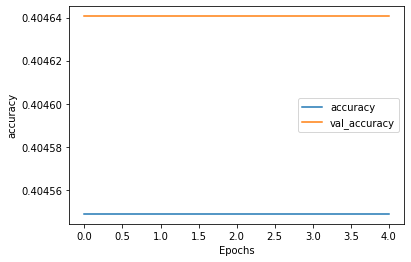

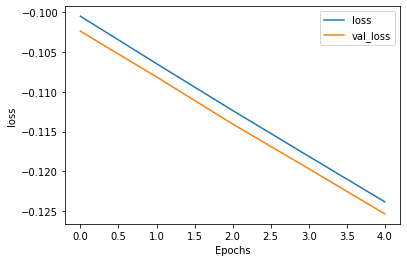

In [147]:
import matplotlib.pyplot as plt


def plot_graphs(history, string):
  plt.plot(history.history[string])
  plt.plot(history.history['val_'+string])
  plt.xlabel("Epochs")
  plt.ylabel(string)
  plt.legend([string, 'val_'+string])
  plt.show()

plot_graphs(history, 'accuracy')
plot_graphs(history, 'loss')